<a href="https://colab.research.google.com/github/iamdata999/UsedVehicleSearch/blob/master/fraud_case_pycaret_classification_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

!pip3 install pycaret
resouce found from kaggle to study how is fraud is acounter below are the lin:
https://www.kaggle.com/arjunjoshua/predicting-fraud-in-financial-payment-services

this exercise just a prectice and to understand how does data with words that convert to numbers prediction using Unsupervised ML compare to random classified then previous project that i done.

In [ ]:
!pip3 install pycaret===2.3.2
!pip3 install shap
!pip install -U pandas-profiling
!pip install pyyaml==5.4.1

In [ ]:
from pycaret.utils import enable_colab
enable_colab()

Colab mode enabled.


In [ ]:
import os
import pandas as pd
import numpy as np

ETL (extract,transform and load)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Load dataset from Google Drive
data_path = '//content/drive/MyDrive/data'
filename = 'insurance_claims.csv'

df = insurance_claims_csv = pd.read_csv(os.path.join(data_path, filename))

EDA (explore data analysis)

In [ ]:
insurance_claims_csv.all

<bound method NDFrame._add_numeric_operations.<locals>.all of      months_as_customer  age  policy_number policy_bind_date policy_state  \
0                   328   48         521585       17/10/2014           OH   
1                   228   42         342868        27/6/2006           IN   
2                   134   29         687698         6/9/2000           OH   
3                   256   41         227811        25/5/1990           IL   
4                   228   44         367455         6/6/2014           IL   
..                  ...  ...            ...              ...          ...   
995                   3   38         941851        16/7/1991           OH   
996                 285   41         186934         5/1/2014           IL   
997                 130   34         918516        17/2/2003           OH   
998                 458   62         533940       18/11/2011           IL   
999                 456   60         556080       11/11/1996           OH   

    policy_cs

In [ ]:
insurance_claims_csv.head()

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,isFraud
0,328,48,521585,17/10/2014,OH,250/500,1000,1406.91,0,466132,...,2,YES,71610,6510,13020,52080,Saab,92x,2004,Y
1,228,42,342868,27/6/2006,IN,250/500,2000,1197.22,5000000,468176,...,0,?,5070,780,780,3510,Mercedes,E400,2007,Y
2,134,29,687698,6/9/2000,OH,100/300,2000,1413.14,5000000,430632,...,3,NO,34650,7700,3850,23100,Dodge,RAM,2007,N
3,256,41,227811,25/5/1990,IL,250/500,2000,1415.74,6000000,608117,...,2,NO,63400,6340,6340,50720,Chevrolet,Tahoe,2014,Y
4,228,44,367455,6/6/2014,IL,500/1000,1000,1583.91,6000000,610706,...,1,NO,6500,1300,650,4550,Accura,RSX,2009,N


In [ ]:
insurance_claims_csv.tail()

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,isFraud
995,3,38,941851,16/7/1991,OH,500/1000,1000,1310.80,0,431289,...,1,?,87200,17440,8720,61040,Honda,Accord,2006,N
996,285,41,186934,5/1/2014,IL,100/300,1000,1436.79,0,608177,...,3,?,108480,18080,18080,72320,Volkswagen,Passat,2015,N
997,130,34,918516,17/2/2003,OH,250/500,500,1383.49,3000000,442797,...,3,YES,67500,7500,7500,52500,Suburu,Impreza,1996,N
998,458,62,533940,18/11/2011,IL,500/1000,2000,1356.92,5000000,441714,...,1,YES,46980,5220,5220,36540,Audi,A5,1998,N
999,456,60,556080,11/11/1996,OH,250/500,1000,766.19,0,612260,...,3,?,5060,460,920,3680,Mercedes,E400,2007,N


In [ ]:
# Creating the index
idx = pd.Index(['months_as_customer', 'age', 'policy_number', 'policy_bind_date',
       'policy_state', 'policy_csl', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_hobbies',
       'insured_relationship', 'capital-gains', 'capital-loss',
       'incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make',
       'auto_model', 'auto_year', 'isFraud'])

# Print the index
print(idx)

# return a tuple of the shape
# of data in idx object
result = idx.shape
result = df.shape

# Print the result
print(result)


Index(['months_as_customer', 'age', 'policy_number', 'policy_bind_date',
       'policy_state', 'policy_csl', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_hobbies',
       'insured_relationship', 'capital-gains', 'capital-loss',
       'incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make',
       'auto_model', 'auto_year', 'isFraud'],
      dtype='object')
(1000, 39)


In [ ]:
from pandas_profiling import ProfileReport
# run profile report
insurance_claims_csv.profile_report(explorative=True)




Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
def checkIfDuplicates_1(listOfElems):
    ''' Check if given list contains any duplicates '''
    if len(listOfElems) == len(set(listOfElems)):
        return False
    else:
        return True


In [ ]:
listOfElems = ['months_as_customer', 'age', 'policy_number', 'policy_bind_date',
       'policy_state', 'policy_csl', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_hobbies',
       'insured_relationship', 'capital-gains', 'capital-loss',
       'incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make',
       'auto_model', 'auto_year', 'isFraud']
result = checkIfDuplicates_1(listOfElems)
if result:
    print('Yes, list contains duplicates')
else:
    print('No duplicates found in list')

No duplicates found in list


great! we can see there is clear from duplicate


The next few preprocessing techniques deals with missing values.

To demonstrate this with variables. hope we are not accounter and may end up with weird results like:  NaN or ?

In [ ]:


# Keep only these variables #vars_to_keep
data_missing = [
    'months_as_customer', 'age', 'policy_number', 'policy_bind_date',
       'policy_state', 'policy_csl', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_hobbies',
       'insured_relationship', 'capital-gains', 'capital-loss',
       'incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make',
       'auto_model', 'auto_year', 'isFraud']

# We create a new dataframe in this step to save the original
# dataset from being modified
data_missing = insurance_claims_csv[data_missing]

# For each column, take 10% and change it to missing value
for c in data_missing.columns:
    data_missing.loc[data_missing.sample(frac=0.1).index, c] = np.nan

In [ ]:
# Inspect the dataset, we see missing values.
data_missing

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,isFraud
0,328.0,48.0,521585.0,17/10/2014,OH,250/500,1000.0,1406.91,NaN,466132.0,...,2.0,YES,71610.0,6510.0,13020.0,NaN,Saab,92x,2004.0,NaN
1,228.0,42.0,342868.0,27/6/2006,IN,250/500,2000.0,1197.22,5000000.0,468176.0,...,0.0,NaN,5070.0,780.0,780.0,3510.0,Mercedes,E400,NaN,Y
2,134.0,29.0,687698.0,6/9/2000,OH,NaN,2000.0,1413.14,5000000.0,430632.0,...,3.0,NO,34650.0,7700.0,3850.0,23100.0,Dodge,RAM,2007.0,N
3,256.0,41.0,227811.0,25/5/1990,IL,250/500,2000.0,NaN,NaN,608117.0,...,2.0,NO,63400.0,NaN,6340.0,50720.0,NaN,Tahoe,NaN,Y
4,228.0,44.0,367455.0,6/6/2014,IL,500/1000,1000.0,1583.91,6000000.0,610706.0,...,1.0,NO,6500.0,1300.0,650.0,NaN,Accura,RSX,2009.0,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,NaN,38.0,941851.0,16/7/1991,OH,500/1000,1000.0,1310.80,0.0,431289.0,...,1.0,?,87200.0,17440.0,8720.0,61040.0,Honda,Accord,2006.0,NaN
996,285.0,41.0,186934.0,NaN,IL,100/300,1000.0,1436.79,0.0,608177.0,...,3.0,?,108480.0,18080.0,18080.0,NaN,Volkswagen,Passat,2015.0,N
997,130.0,34.0,918516.0,NaN,OH,250/500,500.0,1383.49,3000000.0,442797.0,...,3.0,YES,67500.0,7500.0,7500.0,52500.0,NaN,Impreza,1996.0,N
998,458.0,62.0,533940.0,NaN,IL,500/1000,2000.0,1356.92,5000000.0,441714.0,...,1.0,YES,46980.0,5220.0,5220.0,36540.0,Audi,A5,1998.0,NaN


now we can see there is missing value like nan and ? (question marks) so we need to replace rigth now to zero in dataframe.


In [ ]:
df.fillna(0)

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,isFraud
0,328,48,521585,17/10/2014,OH,250/500,1000,1406.91,0,466132,...,2,YES,71610,6510,13020,52080,Saab,92x,2004,Y
1,228,42,342868,27/6/2006,IN,250/500,2000,1197.22,5000000,468176,...,0,?,5070,780,780,3510,Mercedes,E400,2007,Y
2,134,29,687698,6/9/2000,OH,100/300,2000,1413.14,5000000,430632,...,3,NO,34650,7700,3850,23100,Dodge,RAM,2007,N
3,256,41,227811,25/5/1990,IL,250/500,2000,1415.74,6000000,608117,...,2,NO,63400,6340,6340,50720,Chevrolet,Tahoe,2014,Y
4,228,44,367455,6/6/2014,IL,500/1000,1000,1583.91,6000000,610706,...,1,NO,6500,1300,650,4550,Accura,RSX,2009,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,3,38,941851,16/7/1991,OH,500/1000,1000,1310.80,0,431289,...,1,?,87200,17440,8720,61040,Honda,Accord,2006,N
996,285,41,186934,5/1/2014,IL,100/300,1000,1436.79,0,608177,...,3,?,108480,18080,18080,72320,Volkswagen,Passat,2015,N
997,130,34,918516,17/2/2003,OH,250/500,500,1383.49,3000000,442797,...,3,YES,67500,7500,7500,52500,Suburu,Impreza,1996,N
998,458,62,533940,18/11/2011,IL,500/1000,2000,1356.92,5000000,441714,...,1,YES,46980,5220,5220,36540,Audi,A5,1998,N


In [ ]:
df.replace(np.nan,0)

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,isFraud
0,328,48,521585,17/10/2014,OH,250/500,1000,1406.91,0,466132,...,2,YES,71610,6510,13020,52080,Saab,92x,2004,Y
1,228,42,342868,27/6/2006,IN,250/500,2000,1197.22,5000000,468176,...,0,?,5070,780,780,3510,Mercedes,E400,2007,Y
2,134,29,687698,6/9/2000,OH,100/300,2000,1413.14,5000000,430632,...,3,NO,34650,7700,3850,23100,Dodge,RAM,2007,N
3,256,41,227811,25/5/1990,IL,250/500,2000,1415.74,6000000,608117,...,2,NO,63400,6340,6340,50720,Chevrolet,Tahoe,2014,Y
4,228,44,367455,6/6/2014,IL,500/1000,1000,1583.91,6000000,610706,...,1,NO,6500,1300,650,4550,Accura,RSX,2009,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,3,38,941851,16/7/1991,OH,500/1000,1000,1310.80,0,431289,...,1,?,87200,17440,8720,61040,Honda,Accord,2006,N
996,285,41,186934,5/1/2014,IL,100/300,1000,1436.79,0,608177,...,3,?,108480,18080,18080,72320,Volkswagen,Passat,2015,N
997,130,34,918516,17/2/2003,OH,250/500,500,1383.49,3000000,442797,...,3,YES,67500,7500,7500,52500,Suburu,Impreza,1996,N
998,458,62,533940,18/11/2011,IL,500/1000,2000,1356.92,5000000,441714,...,1,YES,46980,5220,5220,36540,Audi,A5,1998,N


In [ ]:
df.replace('?',0)

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,isFraud
0,328,48,521585,17/10/2014,OH,250/500,1000,1406.91,0,466132,...,2,YES,71610,6510,13020,52080,Saab,92x,2004,Y
1,228,42,342868,27/6/2006,IN,250/500,2000,1197.22,5000000,468176,...,0,0,5070,780,780,3510,Mercedes,E400,2007,Y
2,134,29,687698,6/9/2000,OH,100/300,2000,1413.14,5000000,430632,...,3,NO,34650,7700,3850,23100,Dodge,RAM,2007,N
3,256,41,227811,25/5/1990,IL,250/500,2000,1415.74,6000000,608117,...,2,NO,63400,6340,6340,50720,Chevrolet,Tahoe,2014,Y
4,228,44,367455,6/6/2014,IL,500/1000,1000,1583.91,6000000,610706,...,1,NO,6500,1300,650,4550,Accura,RSX,2009,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,3,38,941851,16/7/1991,OH,500/1000,1000,1310.80,0,431289,...,1,0,87200,17440,8720,61040,Honda,Accord,2006,N
996,285,41,186934,5/1/2014,IL,100/300,1000,1436.79,0,608177,...,3,0,108480,18080,18080,72320,Volkswagen,Passat,2015,N
997,130,34,918516,17/2/2003,OH,250/500,500,1383.49,3000000,442797,...,3,YES,67500,7500,7500,52500,Suburu,Impreza,1996,N
998,458,62,533940,18/11/2011,IL,500/1000,2000,1356.92,5000000,441714,...,1,YES,46980,5220,5220,36540,Audi,A5,1998,N


after the convertion all missing data like NaN or ? (Question marks symbal)
lets Checking for missing data by using isnull()
In order in  DataFrame, we use isnull()  this function return dataframe of Boolean values which are True or false for NaN or ? (Question marks symbal) for the test

 lets try convert the words2numberic by use (Label Encoding) refers to converting the labels into a numeric form so as to convert them into the machine-readable form. Machine learning algorithms can then decide in a better way how those labels must be operated. It is an important pre-processing step for the structured dataset in supervised learning.

In [ ]:


# label encoding the data
from sklearn.preprocessing import LabelEncoder

data = insurance_claims_csv = pd.read_csv(os.path.join(data_path, filename))

le = LabelEncoder()


data['isFraud']= le.fit_transform(data['isFraud'])
data['auto_model']= le.fit_transform(data['auto_model'])
data['policy_state']= le.fit_transform(data['policy_state'])
data['insured_sex']= le.fit_transform(data['insured_sex'])
data['insured_education_level']= le.fit_transform(data['insured_education_level'])
data['insured_occupation']= le.fit_transform(data['insured_occupation'])
data['insured_hobbies']= le.fit_transform(data['insured_hobbies'])
data['insured_relationship']= le.fit_transform(data['insured_relationship'])
data['incident_type']= le.fit_transform(data['incident_type'])
data['collision_type']= le.fit_transform(data['collision_type'])
data['incident_severity']= le.fit_transform(data['incident_severity'])
data['authorities_contacted']= le.fit_transform(data['authorities_contacted'])
data['incident_state']= le.fit_transform(data['incident_state'])
data['incident_city']= le.fit_transform(data['incident_city'])
data['incident_location']= le.fit_transform(data['incident_location'])
data['property_damage']= le.fit_transform(data['property_damage'])
data['police_report_available']= le.fit_transform(data['police_report_available'])
data['auto_make']= le.fit_transform(data['auto_make'])


print(data)



     months_as_customer  age  policy_number policy_bind_date  policy_state  \
0                   328   48         521585       17/10/2014             2   
1                   228   42         342868        27/6/2006             1   
2                   134   29         687698         6/9/2000             2   
3                   256   41         227811        25/5/1990             0   
4                   228   44         367455         6/6/2014             0   
..                  ...  ...            ...              ...           ...   
995                   3   38         941851        16/7/1991             2   
996                 285   41         186934         5/1/2014             0   
997                 130   34         918516        17/2/2003             2   
998                 458   62         533940       18/11/2011             0   
999                 456   60         556080       11/11/1996             2   

    policy_csl  policy_deductable  policy_annual_premium  umbre

lets call out string to check all dataframe words2num are in order

Classification models

For Nizam. After you have your cleaned dataset, you can just use pycaret to handle the categorical dummies, train test split, compare all the ML models and get the best model
Binary (yes/no) outcome using logistic regression
Our task is to predict whether an animal is a predator or not, using the other characteristics (except animal_name of course).

Let's implement a logistic regression in statsmodel to see the explanatory power of the features.

In [ ]:
data = insurance_claims_csv

In [ ]:
data.head()

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,isFraud
0,328,48,521585,17/10/2014,2,250/500,1000,1406.91,0,466132,...,2,2,71610,6510,13020,52080,10,1,2004,1
1,228,42,342868,27/6/2006,1,250/500,2000,1197.22,5000000,468176,...,0,0,5070,780,780,3510,8,12,2007,1
2,134,29,687698,6/9/2000,2,100/300,2000,1413.14,5000000,430632,...,3,1,34650,7700,3850,23100,4,30,2007,0
3,256,41,227811,25/5/1990,0,250/500,2000,1415.74,6000000,608117,...,2,1,63400,6340,6340,50720,3,34,2014,1
4,228,44,367455,6/6/2014,0,500/1000,1000,1583.91,6000000,610706,...,1,1,6500,1300,650,4550,0,31,2009,0


In [ ]:
data.shape

(1000, 39)

In [ ]:
data = insurance_claims_csv.sample(frac=0.95, random_state=786)

In [ ]:
data

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,isFraud
104,350,54,939905,31/10/2013,2,500/1000,500,1495.10,0,609374,...,0,0,93480,15580,7790,70110,3,25,2014,0
327,276,47,803294,18/6/1993,1,100/300,1000,1724.09,0,615712,...,0,0,65780,5980,11960,47840,3,34,2014,0
359,292,44,200827,28/2/1997,2,500/1000,500,1097.57,0,462836,...,0,2,61700,6170,6170,49360,10,2,2005,0
556,185,35,618682,4/3/2000,1,500/1000,2000,1421.59,0,442695,...,3,2,4950,900,450,3600,5,14,2011,0
385,115,30,903785,24/8/2000,2,500/1000,500,1757.21,0,477695,...,0,2,49140,5460,5460,38220,5,14,2007,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
275,243,43,367595,3/2/2006,1,500/1000,500,1307.74,0,466137,...,1,1,37530,4170,4170,29190,7,36,2008,0
773,174,33,179538,7/4/2014,1,250/500,2000,1124.43,0,477346,...,1,2,44200,8840,4420,30940,10,2,1995,0
46,163,33,529112,8/1/1990,1,100/300,500,1240.47,0,472573,...,1,0,77110,0,14020,63090,6,10,2014,0
97,29,25,235220,1/11/2014,0,250/500,2000,1352.83,0,464959,...,2,2,64890,7210,7210,50470,9,29,2013,1


In [ ]:
data_unseen = insurance_claims_csv.drop(data.index)

In [ ]:
data_unseen

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,isFraud
5,256,39,104594,12/10/2006,2,250/500,1000,1351.10,0,478456,...,2,1,64100,6410,6410,51280,10,3,2003,1
48,175,34,866931,7/1/2008,1,500/1000,1000,1123.87,8000000,446326,...,0,2,7290,810,810,5670,13,28,1995,0
122,203,38,155724,20/2/1998,0,250/500,500,1394.43,0,606352,...,1,2,55440,0,6160,49280,9,26,1999,1
132,112,27,618659,18/10/2005,2,100/300,500,965.13,0,450341,...,1,0,51000,8500,8500,34000,9,29,2013,0
176,155,34,914815,27/9/1990,1,100/300,500,1706.79,0,462479,...,1,2,77040,8560,8560,59920,6,10,1998,0
201,342,49,505969,7/4/1998,2,250/500,500,1722.95,0,472634,...,0,2,76700,7670,7670,61360,11,21,2006,0
202,219,39,653864,25/4/2007,1,250/500,2000,1281.07,7000000,608371,...,2,1,5920,740,740,4440,3,25,2015,0
212,335,50,565564,7/2/2007,2,100/300,1000,1538.26,6000000,615346,...,3,2,34320,8580,4290,21450,13,28,2009,0
231,298,46,667021,2/5/2007,2,500/1000,1000,1138.42,6000000,477678,...,3,2,33550,3050,6100,24400,13,28,2005,0
276,296,42,586104,16/3/2003,1,250/500,2000,1219.27,0,466970,...,2,1,64080,7120,7120,49840,10,2,2012,0


In [ ]:
data.reset_index(inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)
print('Data for Modeling: ' + str(data.shape))
print('Data For Predictions: ' + str(data_unseen.shape))

Data for Modeling: (950, 39)
Data For Predictions: (50, 39)


In [ ]:
from pycaret.classification import *
%matplotlib inline
import graphviz
#import matplotlib.pyplot as plt
#from xgboost import plot_importance, to_graphviz

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


In [ ]:
#intialize the setup
#clf = setup(insurance_claims_csv, target = 'isFraud')

model_setup = setup(data=insurance_claims_csv, target='isFraud', session_id=265)

,Description,Value
0,session_id,265
1,Target,isFraud
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(1000, 39)"
5,Missing Values,False
6,Numeric Features,15
7,Categorical Features,21
8,Ordinal Features,False
9,High Cardinality Features,False


In [ ]:
best_model = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
gbc,Gradient Boosting Classifier,0.8455,0.8633,0.7346,0.6749,0.6984,0.5956,0.6005,0.452
lightgbm,Light Gradient Boosting Machine,0.8383,0.8697,0.6663,0.6804,0.6640,0.5595,0.5654,0.154
lda,Linear Discriminant Analysis,0.8182,0.8345,0.6467,0.6360,0.6370,0.5164,0.5196,0.046
ridge,Ridge Classifier,0.8139,0.0000,0.5944,0.6360,0.6114,0.4898,0.4924,0.023
ada,Ada Boost Classifier,0.7911,0.8227,0.4735,0.6025,0.5260,0.3955,0.4026,0.302
dt,Decision Tree Classifier,0.7897,0.7266,0.6013,0.5690,0.5818,0.4420,0.4445,0.030
et,Extra Trees Classifier,0.7883,0.8554,0.4330,0.5983,0.4996,0.3706,0.3797,0.501
rf,Random Forest Classifier,0.7783,0.8713,0.2441,0.6370,0.3427,0.2452,0.2883,0.519
lr,Logistic Regression,0.7554,0.5941,0.0291,0.3500,0.0518,0.0332,0.0708,0.282
knn,K Neighbors Classifier,0.6996,0.5448,0.1105,0.2660,0.1540,0.0067,0.0096,0.127


In [ ]:
print(best_model)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=265, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)


In [ ]:
models()

,Name,Reference,Turbo
ID,,,
lr,Logistic Regression,sklearn.linear_model._logistic.LogisticRegression,True
knn,K Neighbors Classifier,sklearn.neighbors._classification.KNeighborsCl...,True
nb,Naive Bayes,sklearn.naive_bayes.GaussianNB,True
dt,Decision Tree Classifier,sklearn.tree._classes.DecisionTreeClassifier,True
svm,SVM - Linear Kernel,sklearn.linear_model._stochastic_gradient.SGDC...,True
rbfsvm,SVM - Radial Kernel,sklearn.svm._classes.SVC,False
gpc,Gaussian Process Classifier,sklearn.gaussian_process._gpc.GaussianProcessC...,False
mlp,MLP Classifier,sklearn.neural_network._multilayer_perceptron....,False
ridge,Ridge Classifier,sklearn.linear_model._ridge.RidgeClassifier,True


In [ ]:
gbc  = create_model('gbc')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8429,0.9023,0.6471,0.6875,0.6667,0.5640,0.5644
1,0.8286,0.8546,0.7647,0.6190,0.6842,0.5683,0.5743
2,0.8571,0.9012,0.8824,0.6522,0.7500,0.6531,0.6677
3,0.8143,0.9046,0.6471,0.6111,0.6286,0.5049,0.5053
4,0.8286,0.7791,0.7647,0.6190,0.6842,0.5683,0.5743
5,0.8571,0.8812,0.8235,0.6667,0.7368,0.6403,0.6470
6,0.8143,0.8237,0.5000,0.6923,0.5806,0.4653,0.4755
7,0.8714,0.8536,0.7778,0.7368,0.7568,0.6695,0.6699
8,0.8714,0.8568,0.8333,0.7143,0.7692,0.6809,0.6847
9,0.8696,0.8756,0.7059,0.7500,0.7273,0.6417,0.6422


In [ ]:
print(gbc)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=265, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)


In [ ]:
knn = create_model('knn')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.6857,0.5827,0.1176,0.2222,0.1538,-0.0172,-0.0185
1,0.6286,0.3968,0.0588,0.0909,0.0714,-0.1475,-0.1530
2,0.7571,0.4279,0.1176,0.5000,0.1905,0.1079,0.1476
3,0.7429,0.6299,0.1765,0.4286,0.2500,0.1262,0.1444
4,0.7286,0.5155,0.1765,0.3750,0.2400,0.1001,0.1107
5,0.6857,0.5705,0.1176,0.2222,0.1538,-0.0172,-0.0185
6,0.7000,0.6469,0.1111,0.2857,0.1600,0.0187,0.0218
7,0.6714,0.4225,0.0000,0.0000,0.0000,-0.1259,-0.1632
8,0.6857,0.6250,0.1111,0.2500,0.1538,-0.0052,-0.0059
9,0.7101,0.6307,0.1176,0.2857,0.1667,0.0268,0.0307


In [ ]:
print(knn)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                     weights='uniform')


In [ ]:
lightgbm  = create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8714,0.9279,0.6471,0.7857,0.7097,0.6281,0.6330
1,0.8143,0.8557,0.6471,0.6111,0.6286,0.5049,0.5053
2,0.8429,0.8590,0.7647,0.6500,0.7027,0.5969,0.6005
3,0.8286,0.8679,0.5882,0.6667,0.6250,0.5145,0.5161
4,0.8571,0.7958,0.8235,0.6667,0.7368,0.6403,0.6470
5,0.8571,0.8868,0.8235,0.6667,0.7368,0.6403,0.6470
6,0.7857,0.8985,0.3333,0.6667,0.4444,0.3295,0.3599
7,0.8429,0.8974,0.6111,0.7333,0.6667,0.5650,0.5690
8,0.8857,0.8996,0.7778,0.7778,0.7778,0.7009,0.7009
9,0.7971,0.8088,0.6471,0.5789,0.6111,0.4744,0.4758


In [ ]:
tuned_lightgbm = tune_model(lightgbm)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8571,0.8990,0.4706,0.8889,0.6154,0.5376,0.5787
1,0.8000,0.8491,0.5294,0.6000,0.5625,0.4335,0.4350
2,0.7429,0.8291,0.4118,0.4667,0.4375,0.2717,0.2726
3,0.8000,0.8668,0.5294,0.6000,0.5625,0.4335,0.4350
4,0.8571,0.8158,0.6471,0.7333,0.6875,0.5954,0.5973
5,0.8286,0.8735,0.7059,0.6316,0.6667,0.5518,0.5533
6,0.8429,0.9295,0.4444,0.8889,0.5926,0.5083,0.5552
7,0.8571,0.8985,0.6667,0.7500,0.7059,0.6120,0.6138
8,0.8429,0.9124,0.6667,0.7059,0.6857,0.5811,0.5815
9,0.7971,0.8314,0.5294,0.6000,0.5625,0.4311,0.4325


In [ ]:
print(lightgbm)

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=265, reg_alpha=0.0, reg_lambda=0.0, silent='warn',
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)


In [ ]:
tuned_gbc = tune_model(gbc)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9000,0.8801,0.7059,0.8571,0.7742,0.7107,0.7163
1,0.7714,0.8391,0.5882,0.5263,0.5556,0.4023,0.4035
2,0.8286,0.8724,0.8824,0.6000,0.7143,0.5981,0.6208
3,0.8143,0.8835,0.6471,0.6111,0.6286,0.5049,0.5053
4,0.7571,0.7458,0.4706,0.5000,0.4848,0.3262,0.3264
5,0.8143,0.8579,0.5882,0.6250,0.6061,0.4847,0.4851
6,0.8714,0.8622,0.7222,0.7647,0.7429,0.6572,0.6577
7,0.8000,0.8910,0.5000,0.6429,0.5625,0.4355,0.4413
8,0.8571,0.8868,0.6111,0.7857,0.6875,0.5968,0.6047
9,0.8261,0.8201,0.5882,0.6667,0.6250,0.5124,0.5141


In [ ]:
print(tuned_gbc)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.15, loss='deviance', max_depth=8,
                           max_features=1.0, max_leaf_nodes=None,
                           min_impurity_decrease=0.1, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=120,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=265, subsample=0.3, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)


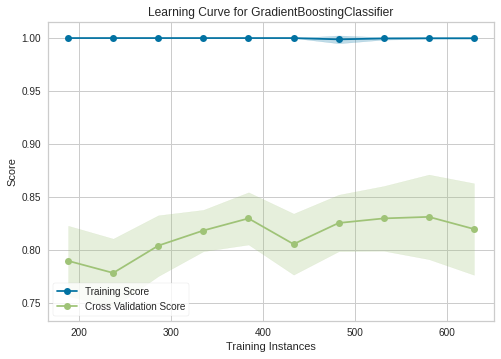

In [ ]:
plot_model(estimator = tuned_gbc, plot = 'learning')

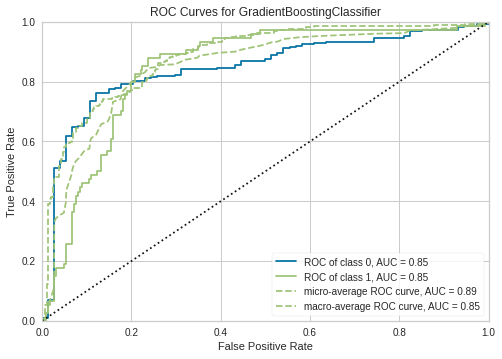

In [ ]:
plot_model(estimator = tuned_gbc, plot = 'auc')

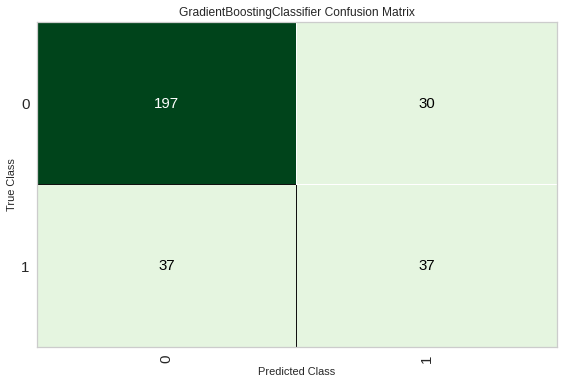

In [ ]:
plot_model(estimator = tuned_gbc, plot = 'confusion_matrix')

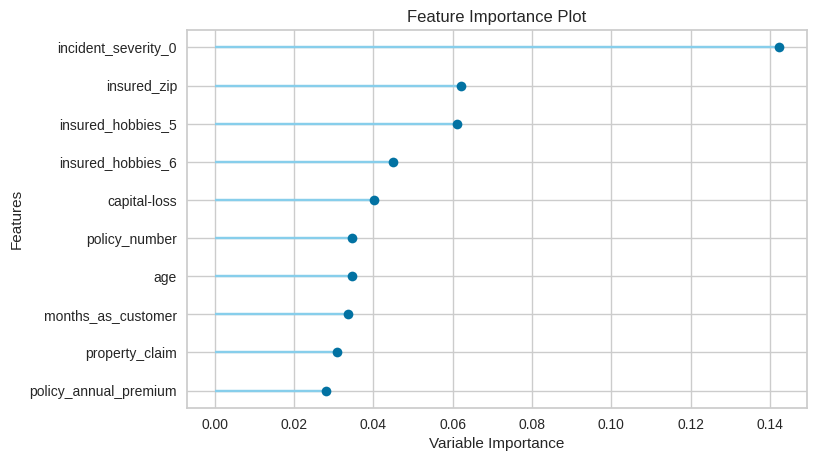

In [ ]:
plot_model(estimator = tuned_gbc, plot = 'feature')

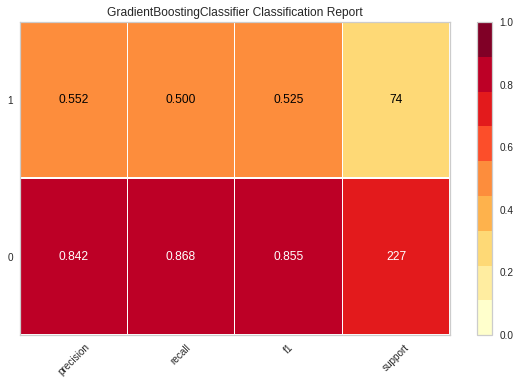

In [ ]:
plot_model(estimator = tuned_gbc, plot = 'class_report')

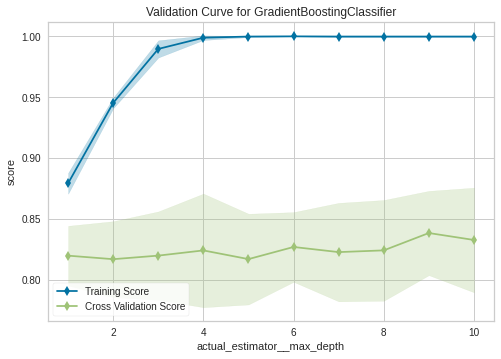

In [ ]:
plot_model(estimator = tuned_gbc, plot = 'vc')

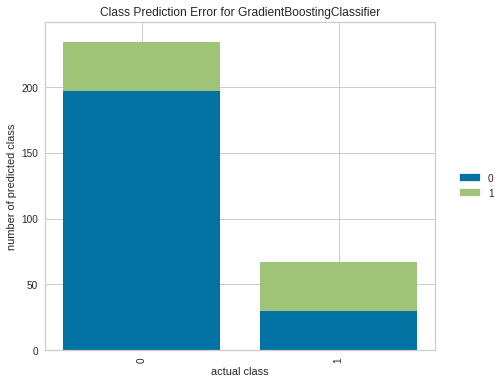

In [ ]:
plot_model(estimator = tuned_gbc, plot = 'error')

In [ ]:
evaluate_model(tuned_gbc)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

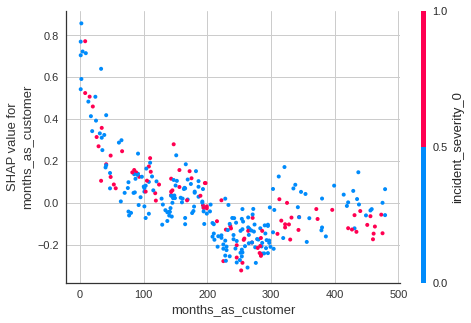

In [ ]:
interpret_model(lightgbm, plot = 'correlation')

In [ ]:
predict_model(gbc)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Gradient Boosting Classifier,0.8007,0.8555,0.6216,0.5897,0.6053,0.4721,0.4723


,months_as_customer,age,policy_number,policy_annual_premium,insured_zip,capital-gains,capital-loss,incident_hour_of_the_day,total_claim_amount,injury_claim,...,incident_date_weekday_2,incident_date_weekday_3,incident_date_weekday_4,incident_date_weekday_5,incident_date_weekday_6,incident_date_is_month_end_0,incident_date_is_month_start_0,isFraud,Label,Score
0,192.0,38.0,744557.0,1281.430054,432405.0,65100.0,-50300.0,10.0,30700.0,3070.0,...,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0,0,0.9585
1,230.0,44.0,372891.0,1009.369995,442210.0,45400.0,-39400.0,19.0,74140.0,13480.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0,0,0.9748
2,295.0,49.0,872814.0,1141.619995,451672.0,34300.0,-24300.0,4.0,4320.0,480.0,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0,0,0.9783
3,451.0,61.0,533941.0,1618.650024,475407.0,0.0,-42600.0,3.0,78100.0,15620.0,...,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1,1,0.6682
4,215.0,42.0,519312.0,1848.810059,435489.0,0.0,-49000.0,20.0,68520.0,11420.0,...,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1,0,0.8307
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
296,1.0,33.0,162004.0,903.320007,451184.0,0.0,0.0,1.0,31700.0,6340.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0,0,0.9417
297,70.0,28.0,265437.0,1319.810059,613587.0,67200.0,-59400.0,14.0,31680.0,3520.0,...,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0,0,0.9498
298,110.0,28.0,435784.0,1573.930054,461919.0,30400.0,0.0,20.0,65040.0,10840.0,...,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0,0,0.9472
299,275.0,45.0,403737.0,1447.770020,605756.0,39400.0,-63900.0,8.0,64320.0,5360.0,...,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0,0,0.9789


In [ ]:
final_gbc = finalize_model(gbc)

In [ ]:
print(final_gbc)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=265, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)


In [ ]:
unseen_predictions = predict_model(final_gbc, data = insurance_claims_csv)
unseen_predictions.head()

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,isFraud,Label,Score
0,328,48,521585,17/10/2014,2,250/500,1000,1406.91,0,466132,...,71610,6510,13020,52080,10,1,2004,1,1,0.6983
1,228,42,342868,27/6/2006,1,250/500,2000,1197.22,5000000,468176,...,5070,780,780,3510,8,12,2007,1,0,0.6851
2,134,29,687698,6/9/2000,2,100/300,2000,1413.14,5000000,430632,...,34650,7700,3850,23100,4,30,2007,0,0,0.9615
3,256,41,227811,25/5/1990,0,250/500,2000,1415.74,6000000,608117,...,63400,6340,6340,50720,3,34,2014,1,1,0.8295
4,228,44,367455,6/6/2014,0,500/1000,1000,1583.91,6000000,610706,...,6500,1300,650,4550,0,31,2009,0,0,0.9678


In [ ]:
print(unseen_predictions)

     months_as_customer  age  policy_number policy_bind_date  policy_state  \
0                   328   48         521585       17/10/2014             2   
1                   228   42         342868        27/6/2006             1   
2                   134   29         687698         6/9/2000             2   
3                   256   41         227811        25/5/1990             0   
4                   228   44         367455         6/6/2014             0   
..                  ...  ...            ...              ...           ...   
995                   3   38         941851        16/7/1991             2   
996                 285   41         186934         5/1/2014             0   
997                 130   34         918516        17/2/2003             2   
998                 458   62         533940       18/11/2011             0   
999                 456   60         556080       11/11/1996             2   

    policy_csl  policy_deductable  policy_annual_premium  umbre

In [ ]:
# you will be able to find this saved file in your runtime
save_model(gbc, model_name='2021_01')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=['incident_location'],
                                       ml_usecase='classification',
                                       numerical_features=[], target='isFraud',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerica...
                                             learning_rate=0.1, loss='deviance',
                                             max_depth=3, max_features=None,
                                             max_leaf_nodes=None,
                                             min_impurity_decrease=0.0,
            

In [ ]:
saved_final_gbc = load_model('2021_01')

Transformation Pipeline and Model Successfully Loaded


In [ ]:
new_prediction = finalize_model(gbc)

In [ ]:
new_prediction = predict_model(saved_final_gbc,data=insurance_claims_csv)

In [ ]:
print(new_prediction)

     months_as_customer  age  policy_number policy_bind_date  policy_state  \
0                   328   48         521585       17/10/2014             2   
1                   228   42         342868        27/6/2006             1   
2                   134   29         687698         6/9/2000             2   
3                   256   41         227811        25/5/1990             0   
4                   228   44         367455         6/6/2014             0   
..                  ...  ...            ...              ...           ...   
995                   3   38         941851        16/7/1991             2   
996                 285   41         186934         5/1/2014             0   
997                 130   34         918516        17/2/2003             2   
998                 458   62         533940       18/11/2011             0   
999                 456   60         556080       11/11/1996             2   

    policy_csl  policy_deductable  policy_annual_premium  umbre

In [ ]:
new_prediction = predict_model(final_gbc,data = insurance_claims_csv)
new_prediction.head()

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,isFraud,Label,Score
0,328,48,521585,17/10/2014,2,250/500,1000,1406.91,0,466132,...,71610,6510,13020,52080,10,1,2004,1,1,0.6983
1,228,42,342868,27/6/2006,1,250/500,2000,1197.22,5000000,468176,...,5070,780,780,3510,8,12,2007,1,0,0.6851
2,134,29,687698,6/9/2000,2,100/300,2000,1413.14,5000000,430632,...,34650,7700,3850,23100,4,30,2007,0,0,0.9615
3,256,41,227811,25/5/1990,0,250/500,2000,1415.74,6000000,608117,...,63400,6340,6340,50720,3,34,2014,1,1,0.8295
4,228,44,367455,6/6/2014,0,500/1000,1000,1583.91,6000000,610706,...,6500,1300,650,4550,0,31,2009,0,0,0.9678


In [ ]:
from pycaret.utils import check_metric
check_metric(new_prediction['isFraud'],new_prediction['Label'], metric="F1")

0.9342